Importing all library

In [1]:
import joblib as jb
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap, MarkerCluster
import seaborn as sns
import math
import eli5
import sklearn
from eli5.sklearn import PermutationImportance
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from folium.plugins import HeatMap, MarkerCluster
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error,r2_score
from sklearn.model_selection import train_test_split
from geopy.geocoders import Nominatim
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

In [2]:
delhi=pd.read_csv("delhi.csv")
mumbai=pd.read_csv("mumbai.csv")
bangalore=pd.read_csv("bangalore.csv")
chennai=pd.read_csv("chennai.csv")
hyderabad=pd.read_csv("hyderabad.csv")
kolkata=pd.read_csv("kolkata.csv")


In [3]:
delhi.describe()

,price,area,latitude,longitude,Bedrooms,Bathrooms,Balcony,parking,Lift,Price_sqft
count,1.206700e+04,12067.000000,12067.000000,12067.000000,12067.000000,12067.000000,8097.000000,4122.000000,2625.000000,12067.000000
mean,1.059850e+07,1488.969504,28.551987,77.263908,2.822823,2.602801,2.394467,7.017225,1.751238,6495.293750
std,1.522026e+07,860.472397,0.107447,0.175177,1.012568,0.986618,1.100556,56.015939,1.183370,5136.900682
min,4.200000e+05,501.000000,28.240023,76.884101,2.000000,2.000000,1.000000,1.000000,0.000000,413.580247
25%,4.400000e+06,999.000000,28.461956,77.081871,2.000000,2.000000,2.000000,1.000000,1.000000,3954.016913
50%,6.670000e+06,1275.000000,28.571502,77.326096,3.000000,2.000000,2.000000,1.000000,2.000000,5138.746146
75%,1.100000e+07,1730.000000,28.641779,77.406492,3.000000,3.000000,3.000000,2.000000,2.000000,7249.161074
max,6.700000e+08,9600.000000,29.005548,77.688028,10.000000,10.000000,10.000000,1406.000000,10.000000,105140.186916


In [4]:
mumbai.describe()

,price,area,latitude,longitude,Bedrooms,Bathrooms,Balcony,parking,Lift,Price_sqft
count,6.255000e+03,6255.000000,6255.000000,6255.000000,6255.000000,6255.000000,2376.000000,2129.000000,1678.000000,6255.000000
mean,2.684187e+07,1185.625260,19.156772,72.868642,2.452278,2.425580,2.162879,4.662283,2.448153,21422.923601
std,2.788831e+07,636.973259,0.109447,0.058614,0.749534,0.762604,1.221899,35.780057,1.566455,12698.478665
min,1.500000e+06,503.000000,18.873713,72.754080,2.000000,0.000000,1.000000,1.000000,0.000000,1500.000000
25%,1.300000e+07,846.500000,19.081509,72.832930,2.000000,2.000000,1.000000,1.000000,2.000000,13709.934735
50%,1.900000e+07,1000.000000,19.147269,72.858019,2.000000,2.000000,2.000000,1.000000,2.000000,19285.714286
75%,3.000000e+07,1300.000000,19.213054,72.884691,3.000000,3.000000,3.000000,2.000000,3.000000,26500.000000
max,3.600000e+08,8000.000000,19.476239,73.197823,10.000000,10.000000,8.000000,801.000000,10.000000,119047.619048


In [5]:
bangalore.describe()

,price,area,latitude,longitude,Bedrooms,Bathrooms,Balcony,parking,Lift,Price_sqft
count,1.113100e+04,11131.000000,11131.000000,11131.000000,11131.000000,11131.000000,7260.000000,4715.000000,3141.000000,11131.000000
mean,1.158064e+07,1619.109514,12.960157,77.633590,2.856527,2.711167,1.897658,8.057264,1.903852,6788.919912
std,1.262915e+07,942.814960,0.090030,0.076590,1.258712,1.215888,0.954175,50.458421,1.126542,4206.102295
min,1.000000e+05,504.000000,12.714300,77.409174,2.000000,0.000000,1.000000,1.000000,0.000000,38.461538
25%,5.800000e+06,1115.000000,12.897167,77.576615,2.000000,2.000000,1.000000,1.000000,1.000000,4682.926829
50%,7.800000e+06,1300.000000,12.964234,77.637786,3.000000,2.000000,2.000000,1.000000,2.000000,5718.206770
75%,1.250000e+07,1700.500000,13.020286,77.695332,3.000000,3.000000,2.000000,2.000000,2.000000,7386.625955
max,3.000000e+08,9700.000000,13.298168,77.894896,10.000000,10.000000,10.000000,999.000000,10.000000,91352.009744


In [6]:
chennai.describe()

,price,area,latitude,longitude,Bedrooms,Bathrooms,Balcony,parking,Lift,Price_sqft
count,5.746000e+03,5746.000000,5746.000000,5746.000000,5746.000000,5746.000000,3023.000000,1802.000000,983.000000,5746.000000
mean,1.080278e+07,1375.515489,13.002970,80.184351,2.683780,2.575879,1.596758,4.373474,1.182096,7184.779301
std,1.350439e+07,861.130258,0.092585,0.058484,1.138642,1.081808,0.859303,32.622040,1.122082,4718.365256
min,1.700000e+06,390.000000,12.802185,80.003439,2.000000,0.000000,1.000000,1.000000,0.000000,1462.450593
25%,4.692500e+06,900.000000,12.934097,80.144358,2.000000,2.000000,1.000000,1.000000,0.000000,4687.500000
50%,6.700000e+06,1108.000000,13.012645,80.193747,2.000000,2.000000,1.000000,1.000000,1.000000,5803.994056
75%,1.100000e+07,1500.000000,13.076123,80.227753,3.000000,3.000000,2.000000,2.000000,2.000000,8000.000000
max,2.400000e+08,9600.000000,13.259562,80.318736,10.000000,10.000000,9.000000,674.000000,10.000000,90270.812437


In [7]:
hyderabad.describe()

,price,area,latitude,longitude,Bedrooms,Bathrooms,Balcony,parking,Lift,Price_sqft
count,6.858000e+03,6858.000000,6858.000000,6858.000000,6858.000000,6858.000000,4877.000000,2233.000000,1583.000000,6858.000000
mean,1.048200e+07,1629.395596,17.446553,78.424157,2.743803,2.678624,1.754767,13.326019,1.989893,6234.377650
std,1.178978e+07,938.807612,0.070159,0.099679,1.068109,1.089256,0.840756,65.839766,1.528043,6133.852691
min,5.000000e+05,304.000000,17.142827,78.081337,2.000000,0.000000,1.000000,1.000000,0.000000,357.142857
25%,5.000000e+06,1100.000000,17.398521,78.354532,2.000000,2.000000,1.000000,1.000000,1.000000,4202.376995
50%,7.300000e+06,1325.000000,17.449760,78.401235,3.000000,2.000000,2.000000,1.000000,1.000000,5294.368815
75%,1.200000e+07,1800.000000,17.501247,78.502054,3.000000,3.000000,2.000000,2.000000,3.000000,6756.756757
max,2.880000e+08,9900.000000,17.657770,78.713993,10.000000,10.000000,10.000000,910.000000,10.000000,117647.058824


In [8]:
kolkata.describe()

,price,area,latitude,longitude,Bedrooms,Bathrooms,Balcony,parking,Lift,Price_sqft
count,6.861000e+03,6861.000000,6861.000000,6861.000000,6861.000000,6861.000000,4678.000000,1625.000000,1346.000000,6861.000000
mean,6.578489e+06,1290.256814,22.569897,88.381410,2.830491,2.298645,1.405301,4.406154,1.387816,4805.228020
std,7.187839e+06,752.261106,0.096363,0.060747,1.178393,0.735707,0.742657,38.205981,0.970019,2446.206584
min,9.000000e+05,350.000000,22.216822,88.026310,2.000000,0.000000,1.000000,1.000000,0.000000,1285.714286
25%,3.200000e+06,860.000000,22.497816,88.349907,2.000000,2.000000,1.000000,1.000000,1.000000,3333.333333
50%,4.570000e+06,1080.000000,22.564301,88.385942,3.000000,2.000000,1.000000,1.000000,1.000000,4213.483146
75%,7.200000e+06,1400.000000,22.628241,88.421136,3.000000,2.000000,2.000000,1.000000,2.000000,5456.634118
max,2.000000e+08,8500.000000,23.115072,88.570175,10.000000,10.000000,10.000000,900.000000,10.000000,40000.000000


1.Droping Address as we already have latitude and longitude.\
2.Droping status and desc as it is of no use.\
3.Assigning 'Semi-Furnished':1 , 'Unfurnished':0 , 'Furnished':2.\
4.Assigning 0 to resale and 1 to new property in neworold.\
5.Assigning 0 to Flat and 1 to Individual House in neworold.\
6.Assigning NaN in landmark to 0 and available string to 1.\
7.Assigning 1 if lift is present and 0 if it is not.\
8.Converting prices to millions ruppe .\
Last:Assigning 0 to remaining NaN values.

In [9]:
def editing(data):
    l=[]
    data=data[data.Price_sqft<75000]
    data.drop(columns=["Address","Status","desc","Price_sqft"],inplace=True)
    data.neworold.replace(["Resale","New Property",'Other\n\t\t\t\t\t\t\t\t\tGet Documents Verified'],[0,1,0],inplace=True)
    data.type_of_building.replace(["Flat","Individual House"],[0,1],inplace=True)
    data.Furnished_status.replace(['Semi-Furnished', 'Unfurnished', 'Furnished'],[1,0,2],inplace=True)
    
    for i in data.Landmarks:
        if type(i)==str:
            l.append(1)
        else:
            l.append(0)
    data.Landmarks=l
    data.replace(np.nan,0,inplace=True)
    l=[]
    for i in data.Lift:
        if i>0:
            l.append(1)
        else:
            l.append(0)
    data.Lift=l
    l=[]        
    for i in data.parking:
        if i>0:
            l.append(1)
        else:
            l.append(0)        
    data.parking=l
    data.price=data.price/1000000
    data=data[data.price<100]
    data=data[data.price>1]
    return data            

In [10]:
delhi=editing(delhi)
mumbai=editing(mumbai)
bangalore=editing(bangalore)
chennai=editing(chennai)
kolkata=editing(kolkata)
hyderabad=editing(hyderabad)

Data Exploration

In [11]:
sns.set_style("whitegrid")

In [12]:
def map_func(data):
    map_data=data[['latitude','longitude','price']]
    city_map = folium.Map(location=[data.latitude.mean(),data.longitude.mean()], zoom_start=9.5, tiles='openstreetmap')
    mc = MarkerCluster()
    for idx, row in map_data.iterrows():
        popup = """
        Price : <b>%s</b><br>
        """ % ( row['price'])
        mc.add_child(folium.Marker([row['latitude'], row['longitude']],tooltip=popup))
        city_map.add_child(mc)
    return city_map

In [13]:
map_func(delhi)

In [14]:
map_func(mumbai)

In [15]:
map_func(bangalore)

In [16]:
map_func(chennai)

In [17]:
map_func(kolkata)

In [18]:
map_func(hyderabad)

In [19]:
def kdehist(data, title):
    x=data.price
    fig, ax = plt.subplots(2,1,figsize=(20,10),sharex=True)
    sns.distplot(x, ax=ax[0])
    ax[0].set(xlabel=None)
    ax[0].set_title('Histogram + KDE')
    sns.violinplot(x, ax=ax[1])
    ax[1].set(xlabel=None)
    ax[1].set_title('Violin plot')
    fig.suptitle(title, fontsize=16)
    plt.tight_layout(pad=3.0)
    plt.show()
    norm = plt.Normalize(x.min(), x.max())
    sm = plt.cm.ScalarMappable(cmap="Dark2", norm=norm)
    sm.set_array([])
    ax=sns.scatterplot(x="longitude",y="latitude",data=data, alpha=0.4 ,cmap=plt.get_cmap("Dark2"),hue="price",palette="Dark2")
    ax.get_legend().remove()
    s=ax.figure.colorbar(sm)
    s.ax.set_title("Price")


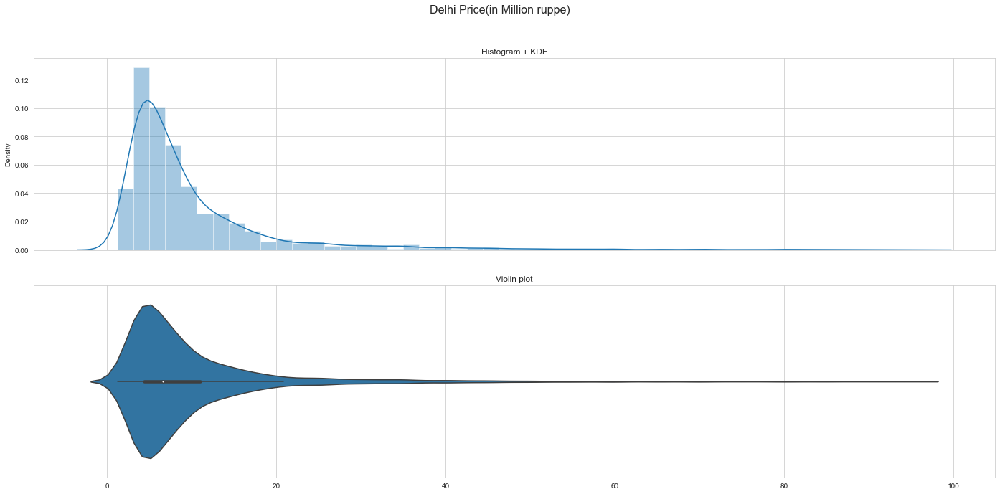

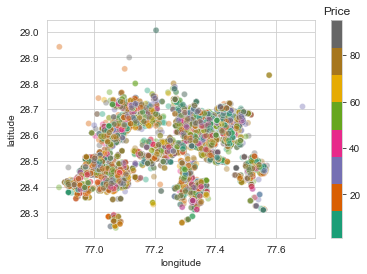

In [20]:
kdehist(delhi,"Delhi Price(in Million ruppe)")

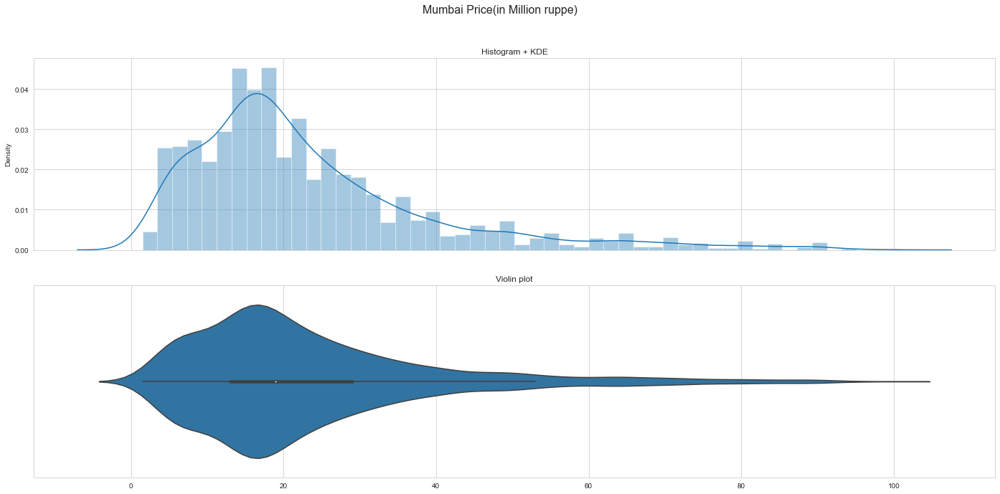

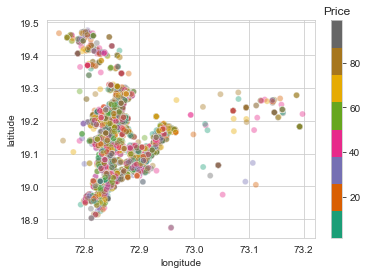

In [21]:
kdehist(mumbai,"Mumbai Price(in Million ruppe)")

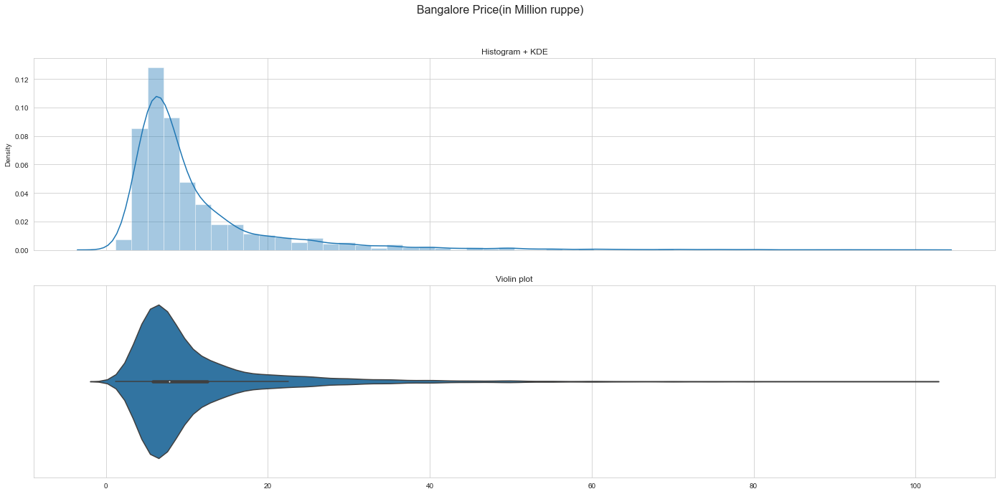

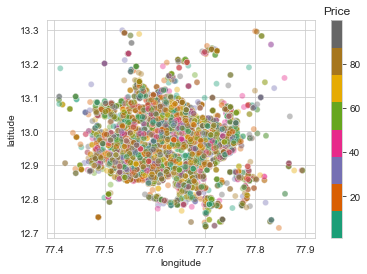

In [22]:
kdehist(bangalore,"Bangalore Price(in Million ruppe)")

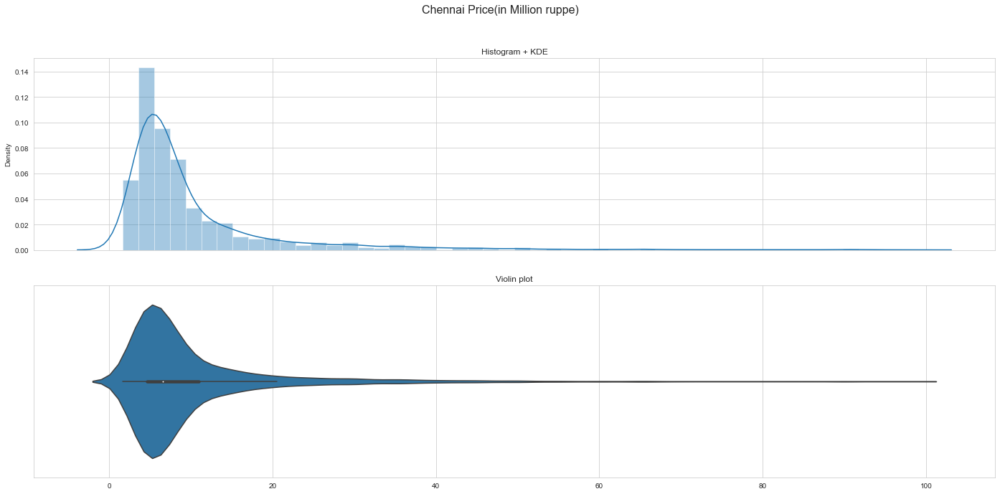

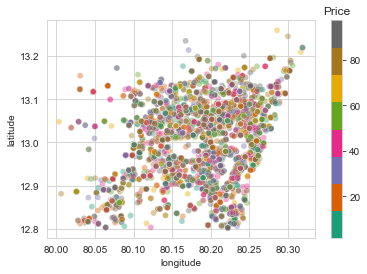

In [23]:
kdehist(chennai,"Chennai Price(in Million ruppe)")

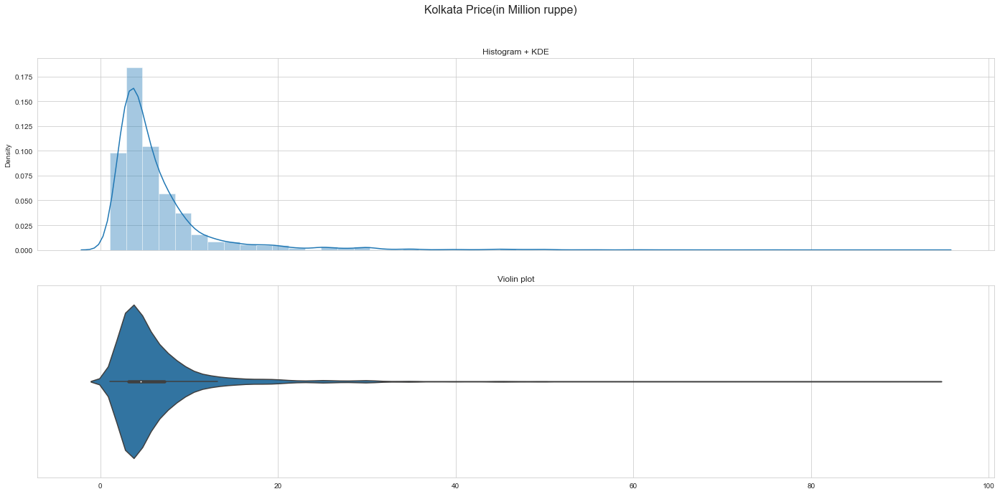

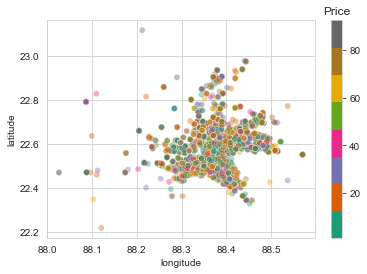

In [24]:
kdehist(kolkata,"Kolkata Price(in Million ruppe)")

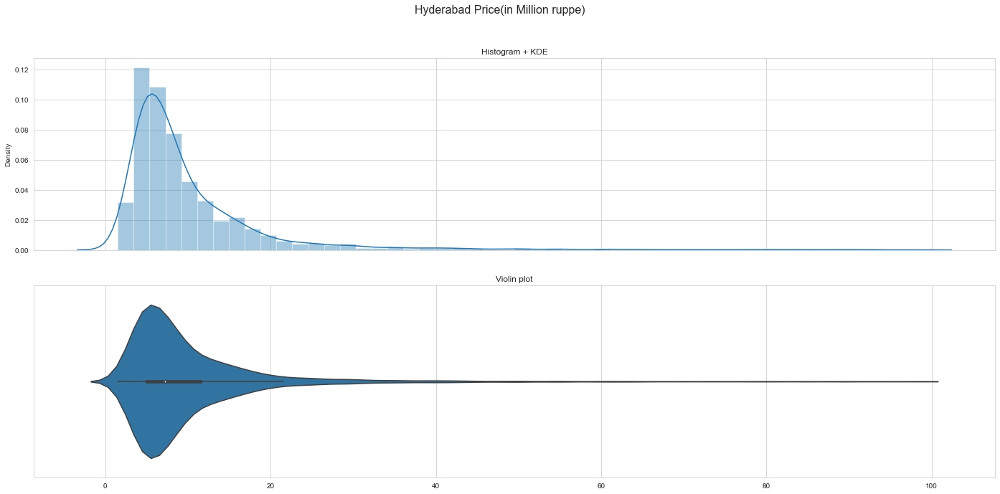

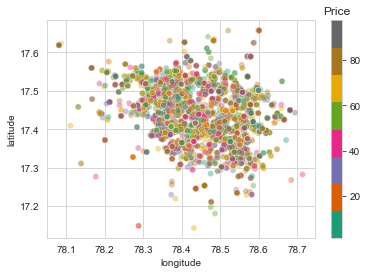

In [25]:
kdehist(hyderabad,"Hyderabad Price(in Million ruppe)")

In [26]:
delhi.columns

Index(['price', 'area', 'latitude', 'longitude', 'Bedrooms', 'Bathrooms',
       'Balcony', 'neworold', 'parking', 'Furnished_status', 'Lift',
       'Landmarks', 'type_of_building'],
      dtype='object')

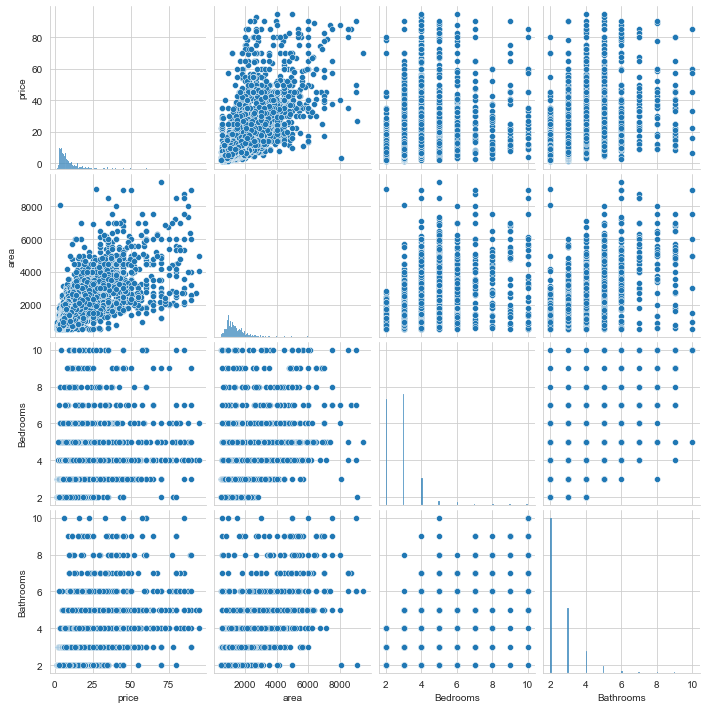

In [27]:
l=['price', 'area', 'Bedrooms', 'Bathrooms']
sns.pairplot(delhi[l])

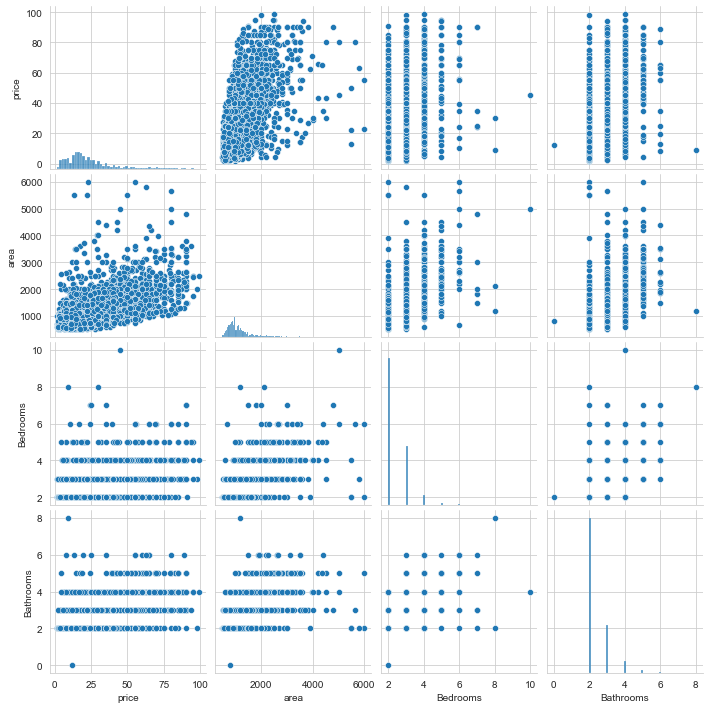

In [28]:
sns.pairplot(mumbai[l])

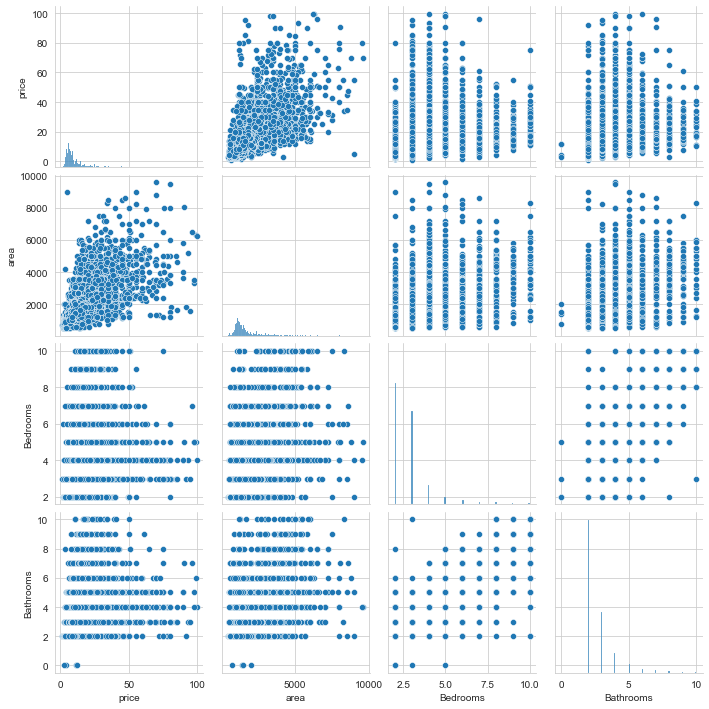

In [29]:
sns.pairplot(bangalore[l])

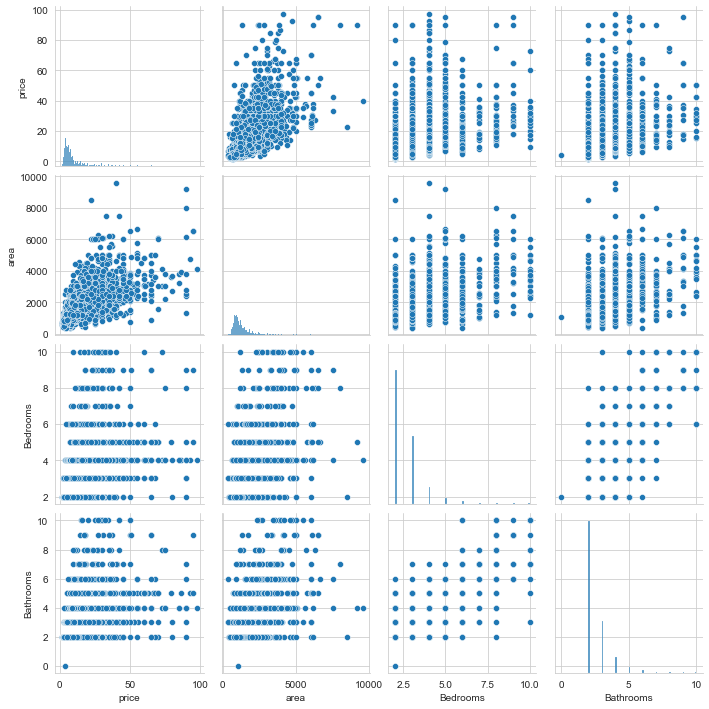

In [30]:
sns.pairplot(chennai[l])

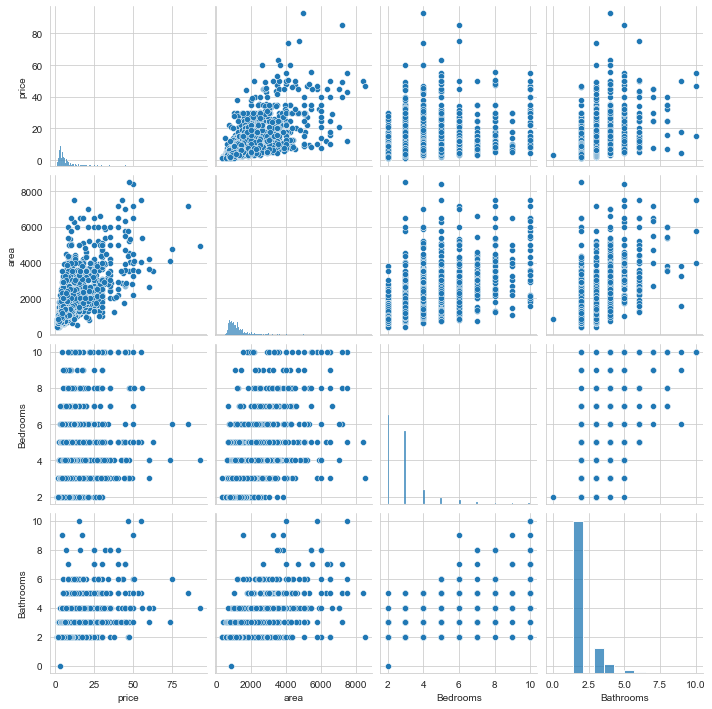

In [31]:
sns.pairplot(kolkata[l])

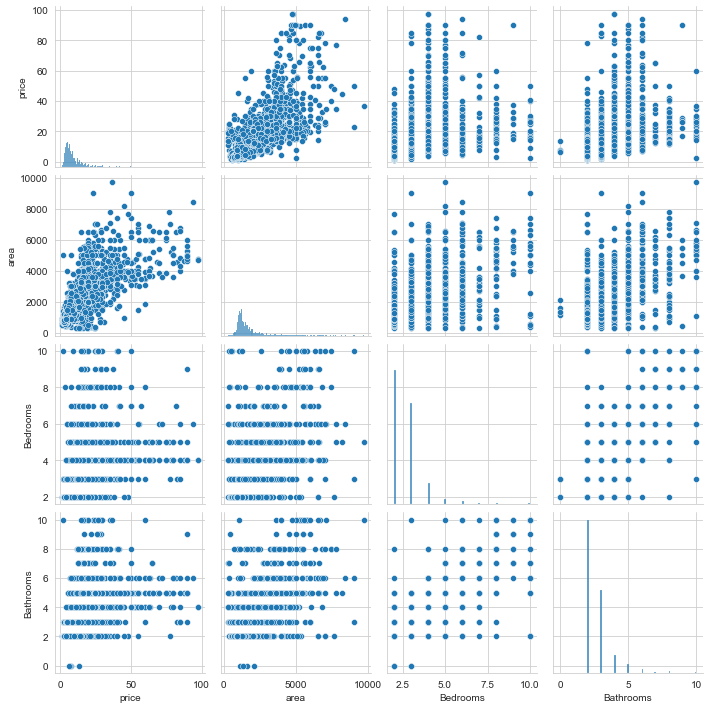

In [32]:
sns.pairplot(hyderabad[l])

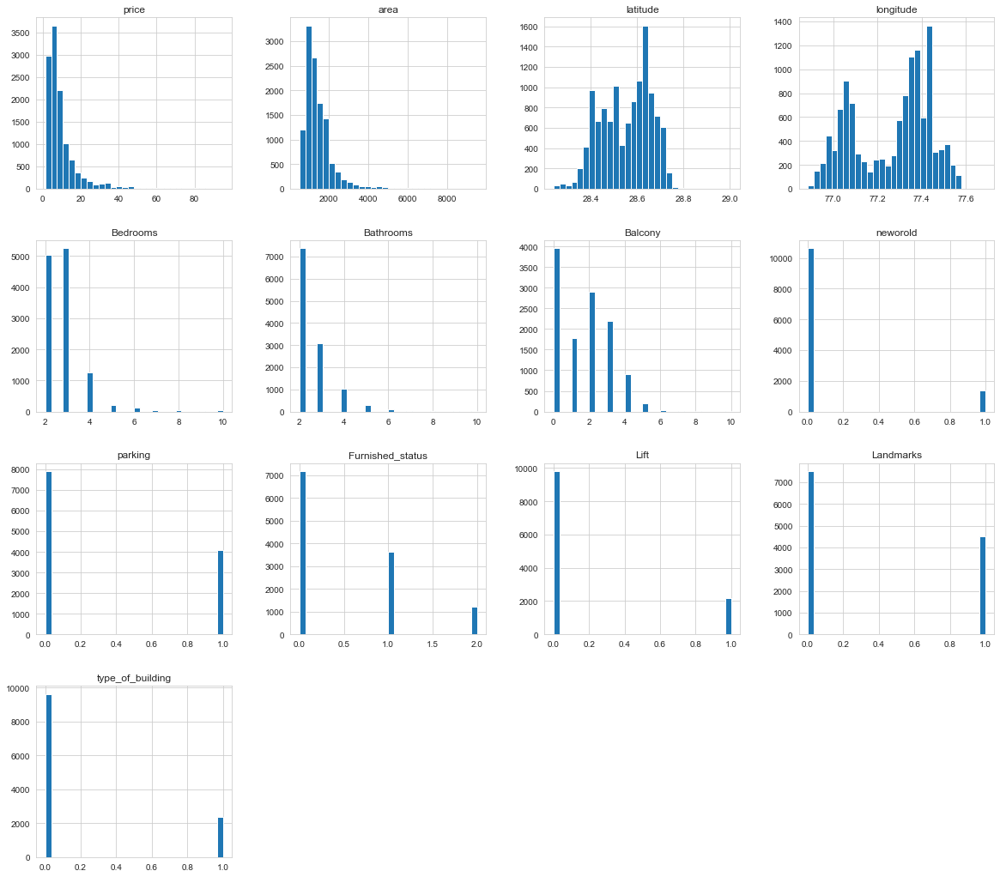

In [33]:
delhi.hist(bins=30,figsize=(20,18))
plt.show()

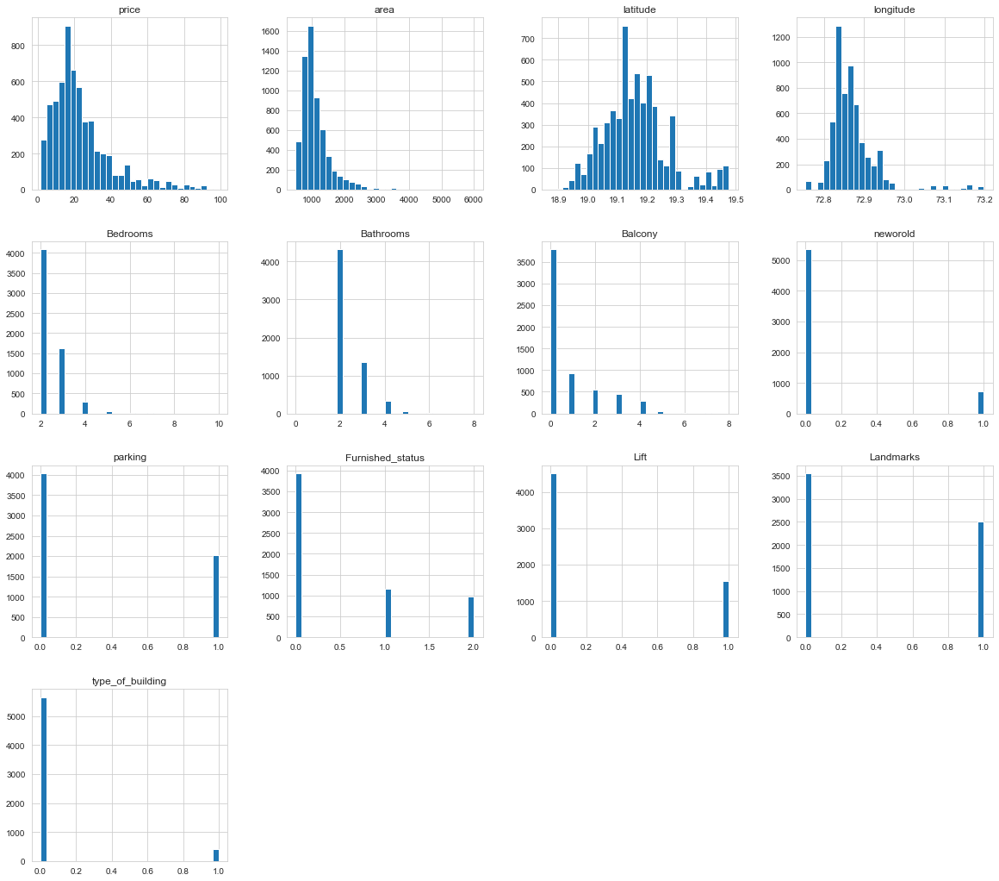

In [34]:
mumbai.hist(bins=30,figsize=(20,18))
plt.show()

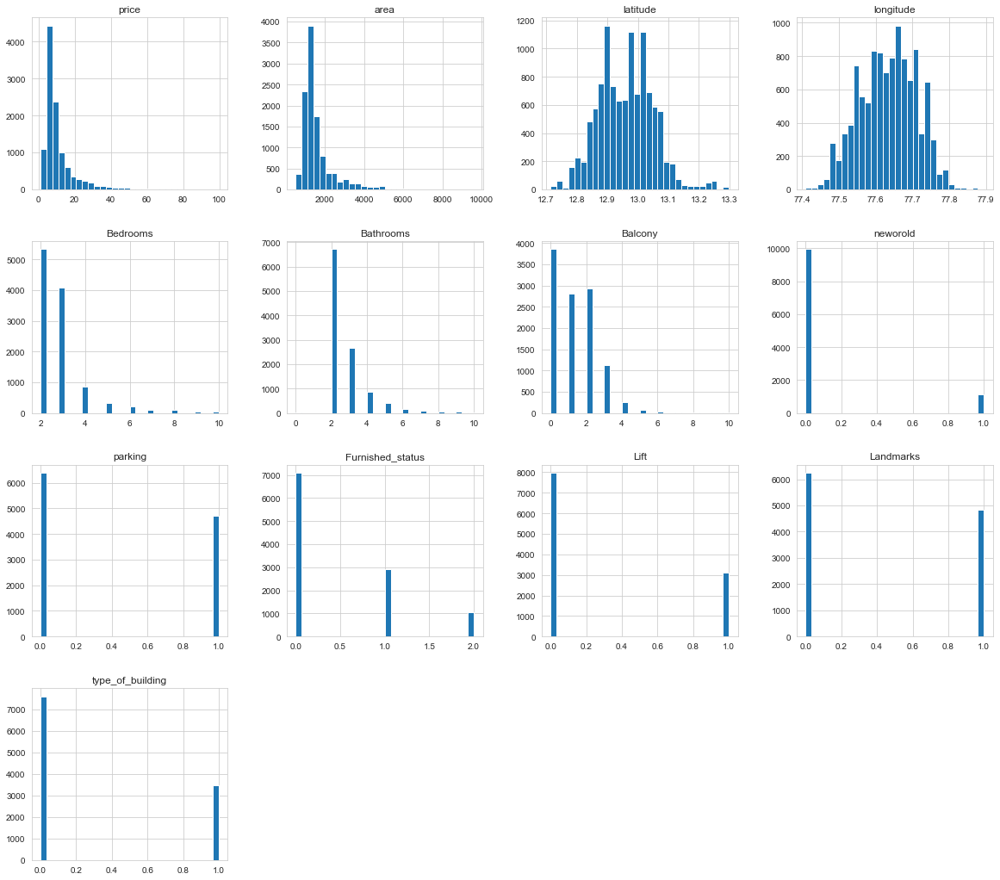

In [35]:
bangalore.hist(bins=30,figsize=(20,18))
plt.show()

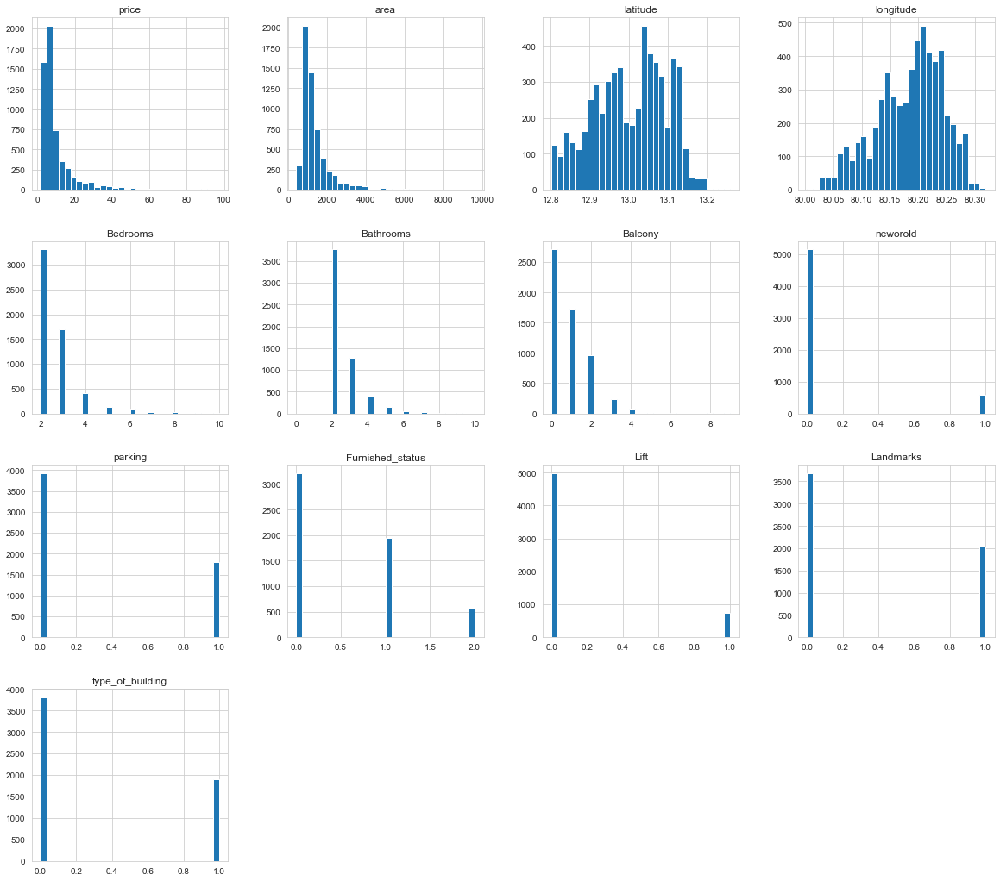

In [36]:
chennai.hist(bins=30,figsize=(20,18))
plt.show()

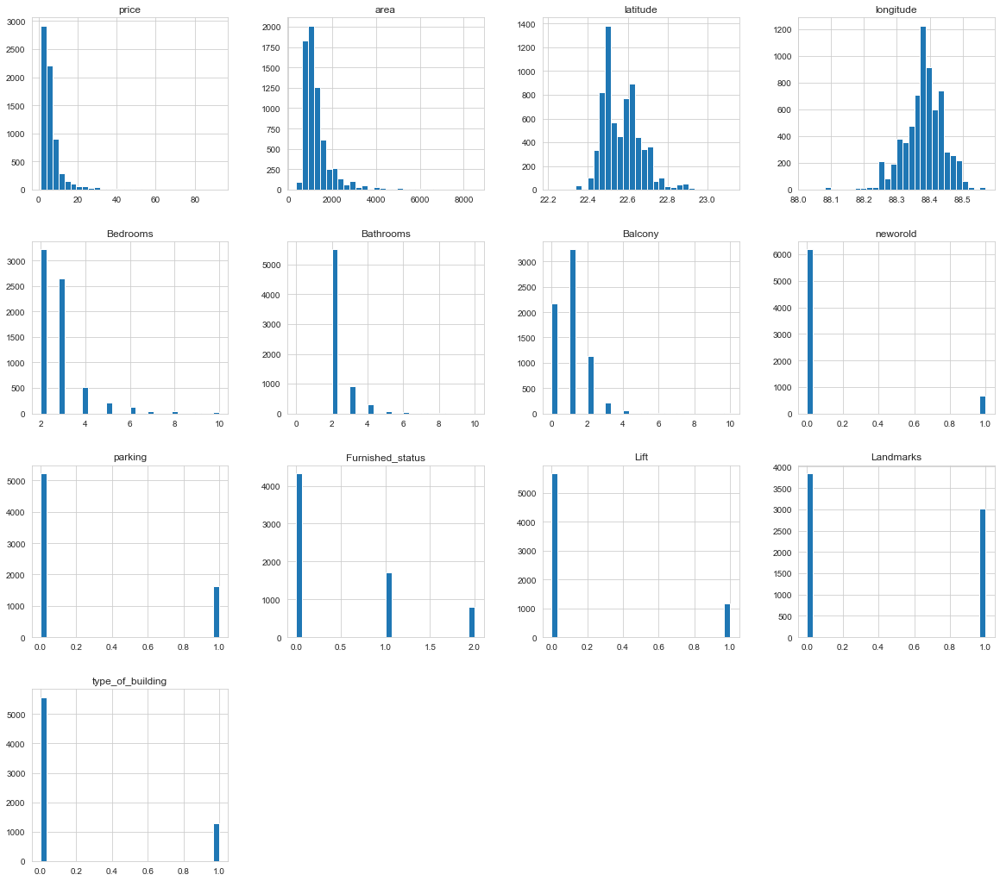

In [37]:
kolkata.hist(bins=30,figsize=(20,18))
plt.show()

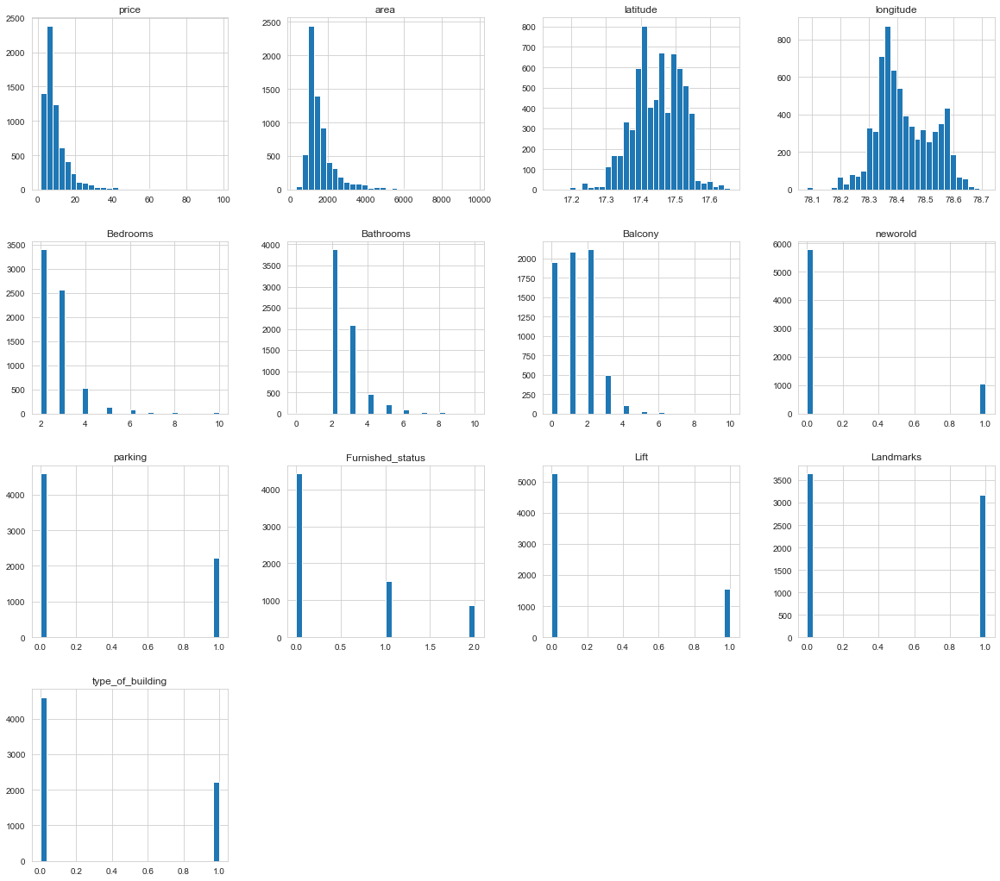

In [38]:
hyderabad.hist(bins=30,figsize=(20,18))
plt.show()

In [39]:
def corr_func(data,title):
    plt.figure(figsize=(30,25))
    corr_matrix=data.corr()
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
    fig=sns.heatmap(data.corr(),mask=mask, cmap="YlGnBu", vmax=1, center=0, fmt="f",square=True, linewidths=.5,annot=True)
    plt.title(title, fontsize=24)
    plt.show()

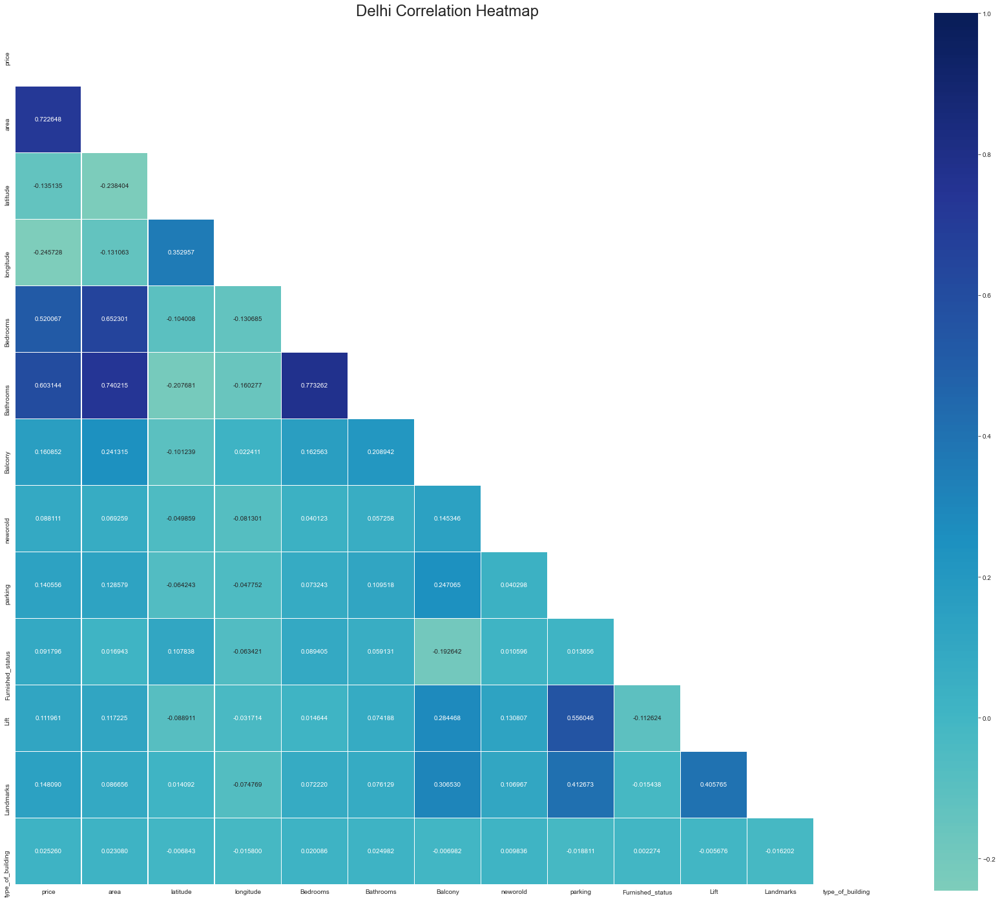

In [40]:
corr_func(delhi,"Delhi Correlation Heatmap")

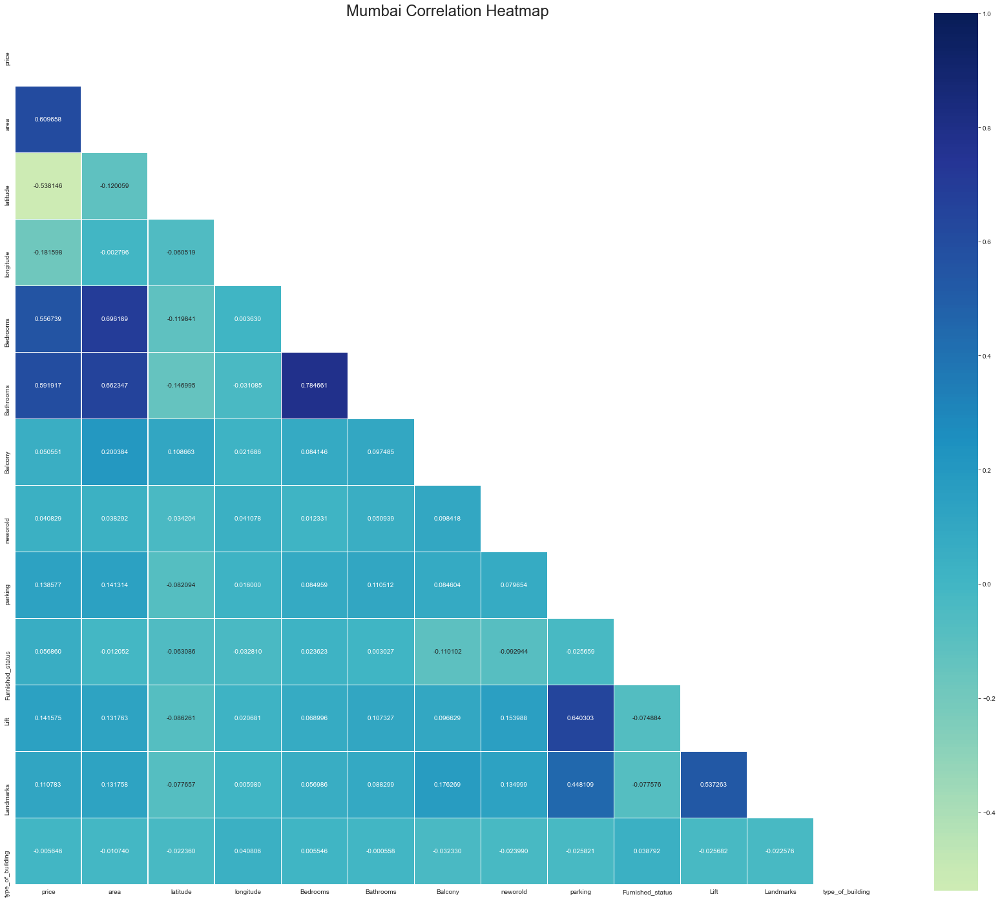

In [41]:
corr_func(mumbai,"Mumbai Correlation Heatmap")

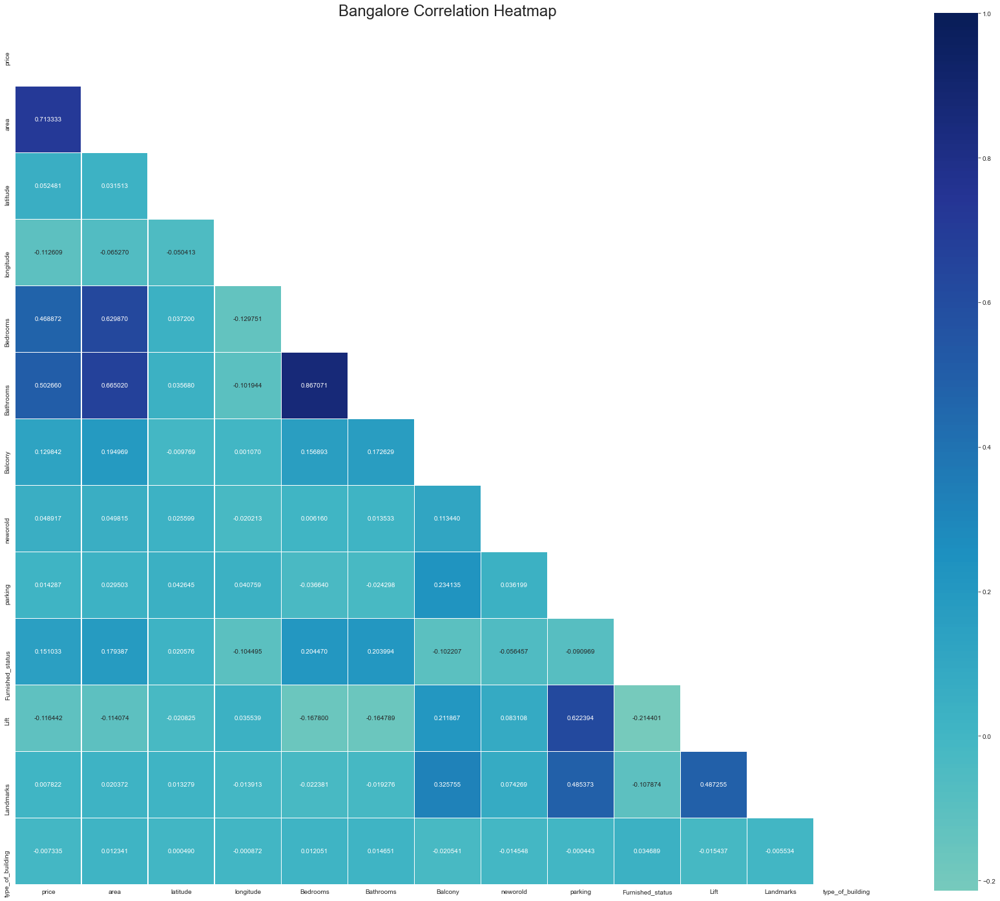

In [42]:
corr_func(bangalore,"Bangalore Correlation Heatmap")

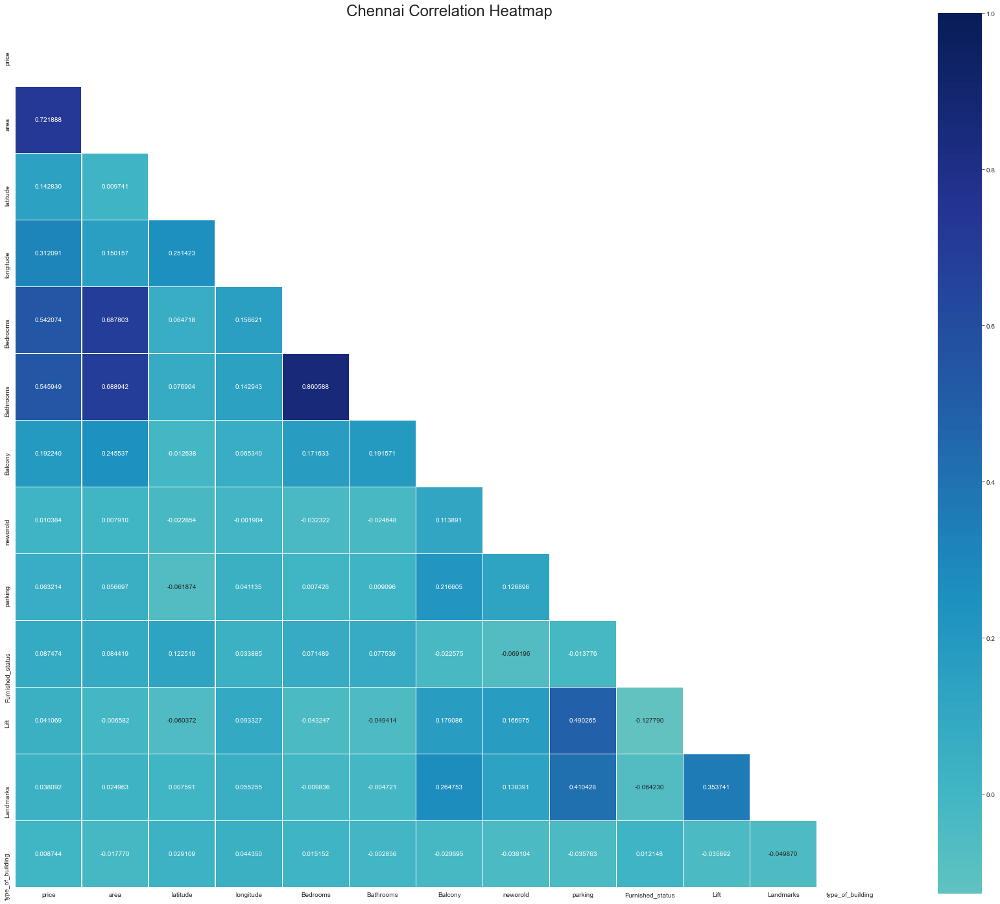

In [43]:
corr_func(chennai,"Chennai Correlation Heatmap")

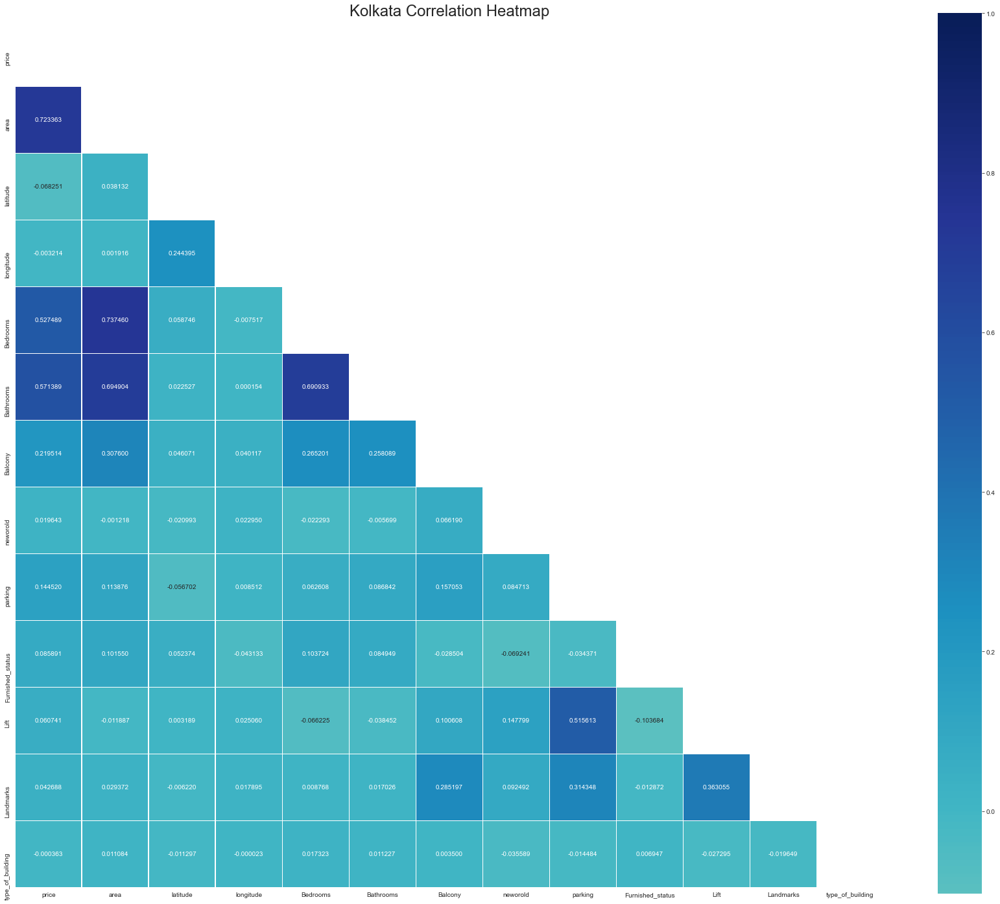

In [44]:
corr_func(kolkata,"Kolkata Correlation Heatmap")

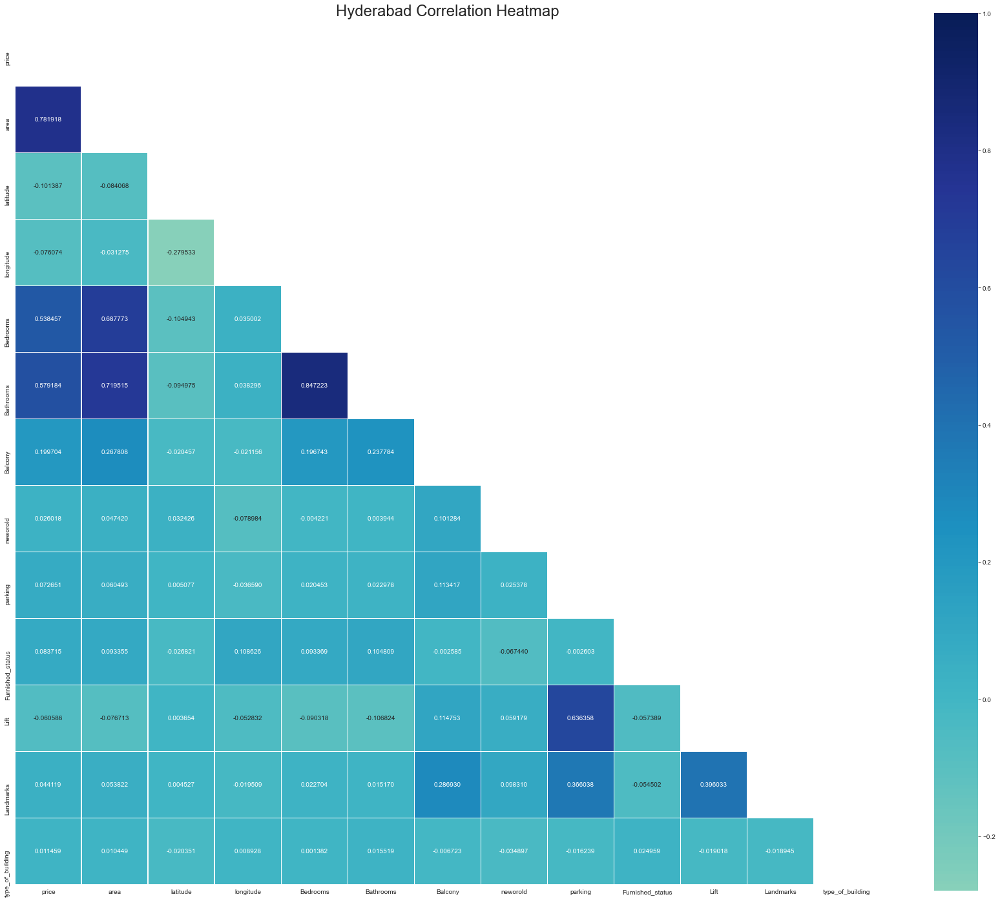

In [45]:
corr_func(hyderabad,"Hyderabad Correlation Heatmap")

Model

In [46]:
def model(data,city):
    X=data.drop(columns="price")
    y=data["price"]
    forest_reg=RandomForestRegressor(n_jobs=-1, random_state=42,max_features=7,min_samples_leaf=2)
    forest_reg.fit(X,y)  
    jb.dump(forest_reg,city+".pkl")

In [47]:
model(delhi,"delhi")
model(mumbai,"mumbai")
model(bangalore,"bangalore")
model(chennai,"chennai")
model(kolkata,"kolkata")
model(hyderabad,"hyderabad")

In [48]:
model=jb.load("mumbai.pkl")
X=mumbai.drop(columns="price")
y=mumbai["price"]


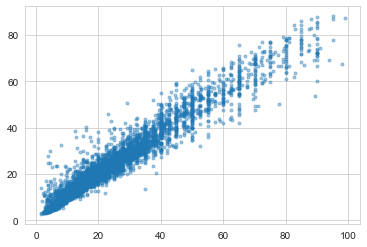

In [49]:
predicted=model.predict(X)
plt.scatter(y,predicted,alpha=0.4,marker=".")

In [ ]:
sns.lineplot(y,predicted)
plt.